# Load & process data

In [1]:
# import torch geometric via pip wheels
import argparse
import os
import time
import networkx as nx
import torch
import torch.optim as optim
from torch_geometric.datasets import TUDataset
from torch_geometric.datasets import Planetoid
from torch_geometric.data import DataLoader
import torch_geometric.nn as pyg_nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse as sp
from torch_geometric.utils import to_networkx
import collections
from tqdm import tqdm

/Users/elisa.gomezdelope/opt/anaconda3/envs/py-pytorch/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Load metabolic network from KEGG compounds

In [190]:
# get human PPI network/graph from downloaded file

kegg_file = "../data/KEGG/kegg_links_filtered.csv"
kegg_links = pd.read_csv(kegg_file)
kegg_links

,metabolite1,metabolite2,reactions,reaction_score
0,M35,M93,R00668,1
1,M35,M444,R00668,1
2,M35,M561,R00668,1
3,M93,M98,R12688,1
4,M93,M189,R03451,1
...,...,...,...,...
838,M100001933,M100015982,R08313,1
839,M100001992,M100002028,"R03406, R02499, R03407",3
840,M100002067,M100002129,"R08978, R08942",2
841,M100002410,M100002968,R05727,1


Since KEGG is a manually curated resource, all links will be considered. Weight (reaction score) is assigned based on the number of reactions two metabolites participate in together.

In [191]:
kegg_links['reaction_score'].describe()

count    843.000000
mean       2.193357
std        6.831835
min        1.000000
25%        1.000000
50%        1.000000
75%        2.000000
max      148.000000
Name: reaction_score, dtype: float64

The distribution of values is skewed, with some really large outliers (e.g. max=148). As we want the score to be >1 but to be compressed in a smaller range to avoid outlier scores have a very large effect on the relevance of the links, the score will be scaled by dividing by a constant factor (10) and transformed by the square root transformation to compress large values more than smaller ones (the distribution is right-skewed). The goal is to reduce the scale of the score values and mitigate the impact of larger values simultaneously. In statistical terms, the square root transformation is often used when dealing with count data or data that has a Poisson distribution. It helps stabilize the variance and make the data more symmetric.

In [192]:
kegg_links['Scaled_reaction_score'] = (kegg_links[['reaction_score']]/ 10)** 0.5
kegg_links

,metabolite1,metabolite2,reactions,reaction_score,Scaled_reaction_score
0,M35,M93,R00668,1,0.316228
1,M35,M444,R00668,1,0.316228
2,M35,M561,R00668,1,0.316228
3,M93,M98,R12688,1,0.316228
4,M93,M189,R03451,1,0.316228
...,...,...,...,...,...
838,M100001933,M100015982,R08313,1,0.316228
839,M100001992,M100002028,"R03406, R02499, R03407",3,0.547723
840,M100002067,M100002129,"R08978, R08942",2,0.447214
841,M100002410,M100002968,R05727,1,0.316228


In [193]:
kegg_links['Scaled_reaction_score'].describe()

count    843.000000
mean       0.405879
std        0.233801
min        0.316228
25%        0.316228
50%        0.316228
75%        0.447214
max        3.847077
Name: Scaled_reaction_score, dtype: float64

In [194]:
# check whether links are unique or duplicate
kegg_links[(kegg_links["metabolite1"] == "M35") | (kegg_links["metabolite2"] == "M35")]

,metabolite1,metabolite2,reactions,reaction_score,Scaled_reaction_score
0,M35,M93,R00668,1,0.316228
1,M35,M444,R00668,1,0.316228
2,M35,M561,R00668,1,0.316228


In [195]:
print(len(kegg_links.metabolite1.unique()))
print(len(kegg_links.metabolite2.unique()))

155
301


Edges are not duplicated.

### Load metabolic network from STITCH compounds

In [2]:
# get human PPI network/graph from downloaded file

stitch_file = "../data/STITCH/stitch_links_annotated_mmi.csv"
stitch_links = pd.read_csv(stitch_file)
stitch_links

,metabolite1,metabolite2,combined_score
0,M100002911,M1135,879
1,M100015785,M100000665,772
2,M100002719,M848,965
3,M100015794,M100002725,750
4,M100015794,M100002808,778
...,...,...,...
5668,M1004,M100002489,828
5669,M1134,M100004518,982
5670,M1134,M100002489,744
5671,M171,M100004518,912


In [315]:
stitch_links['combined_score'].describe()

count    5673.000000
mean      899.754980
std        80.729368
min       700.000000
25%       861.000000
50%       921.000000
75%       959.000000
max       999.000000
Name: combined_score, dtype: float64

In [3]:
stitch_links.loc[:,"combined_score"] = stitch_links.loc[:,"combined_score"]/1000 # scale values between 0 and 1

In [4]:
# check whether links are unique or duplicate
stitch_links[(stitch_links["metabolite1"] == "M35") | (stitch_links["metabolite2"] == "M35")]

,metabolite1,metabolite2,combined_score
747,M35,M93,0.924
748,M35,M209,0.900
749,M35,M231,0.964
750,M35,M482,0.900
751,M35,M480,0.918
752,M35,M823,0.900
753,M35,M252,0.912
874,M252,M35,0.912
949,M823,M35,0.900
1378,M480,M35,0.918


In [5]:
print(len(stitch_links.metabolite1.unique()))
print(len(stitch_links.metabolite2.unique()))

557
557


Edges are duplicated.

### Load metabolomics from the LuxPARK cohort (STITCH)


In [6]:
## LuxPARK data pre-processed 
metab_file = "../data/log_transformed_V0.tsv"
metab = pd.read_csv(metab_file, sep='\t')
print(metab.shape)

(1136, 1407)


In [189]:
metab

,PATIENT_ID,VISIT,SAMPLE_ID,M35,M50,M55,M62,M93,M111,M112,...,M999926058,M999926062,M999926097,M999926106,M999926107,M999926108,M999926109,M999926111,M999926119,M999926158
0,ND0002,V0,LUXE-00925,-2.186712,0.533377,-0.693416,-0.321922,0.290112,-0.418145,0.107916,...,-0.295026,0.739648,-0.528307,0.434771,0.251542,0.374203,0.314129,-0.207933,-0.233884,-0.317124
1,ND0004,V0,LUXE-00919,-2.186712,-0.581002,0.254808,0.206895,-0.469051,-0.368679,0.626702,...,-3.039431,-2.615141,-0.055900,-0.780259,-0.436910,0.184158,1.054430,-0.437471,-0.124976,-1.551153
2,ND0007,V0,LUXE-00923,0.119562,0.286290,0.307139,-0.437526,0.232707,0.537192,0.269326,...,0.475420,-1.486804,0.157839,0.418905,0.321896,0.370202,-2.310234,0.311712,0.483004,-1.551153
3,ND0009,V0,LUXE-00076,-0.194917,0.590285,0.290486,-0.081252,0.116949,0.034914,-0.022594,...,-3.039431,-2.615141,-0.338974,-0.298831,-0.116943,-0.131827,0.882377,0.755042,-0.788712,-1.551153
4,ND0010,V0,LUXE-00918,-0.251999,-0.492667,0.270773,-0.470124,-0.329769,-0.229223,-0.759131,...,0.028338,1.747855,-0.363915,-0.101308,-0.163629,0.029554,-2.310234,-1.119096,0.014215,-0.399393
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1131,ND7228,V0,LUXE-00096,0.360070,-0.357272,-0.997047,-1.974374,-0.129786,0.067214,-0.159470,...,0.478058,-0.025935,1.024332,-0.842566,-0.200144,-0.079440,-1.468188,-0.684232,-0.796015,-1.551153
1132,ND7230,V0,LUXE-00157,-0.027198,-0.847879,-0.989315,0.344390,0.092807,0.092980,-0.581799,...,0.232376,-2.615141,0.469032,-0.213724,-0.399741,-0.804782,0.007286,-0.237484,-0.061164,-1.551153
1133,ND7232,V0,LUXE-00171,0.316976,-0.492807,-0.863229,0.517487,0.052710,0.315469,1.146734,...,0.586568,-0.622468,0.116710,-2.632719,-0.740126,-0.435902,-0.367684,1.293923,-0.022831,-1.012330
1134,ND7237,V0,LUXE-01392,0.357491,-0.141723,-0.155861,-0.682651,0.068036,0.340767,0.389142,...,-3.039431,-1.297452,0.207293,0.314232,0.112064,0.158417,-0.570367,1.134483,0.108944,-1.551153


In [115]:
# print number of unique metabolites in stitch_links and in metabolomics data
print(len(set(stitch_links['metabolite1'].unique()) | set(stitch_links['metabolite2'].unique())))
print(len(metab.columns))

557
1407


In [116]:
metabolites_stitch = stitch_links['metabolite1'].tolist() + stitch_links['metabolite2'].tolist()
len(np.unique(metabolites_stitch))

557

In [117]:
# filter genes existing in metab and stitch_links
print(len(stitch_links.metabolite1.unique()))
print(len(stitch_links.metabolite2.unique()))
print(len(metab.columns.unique()))

metabolites = np.intersect1d(stitch_links.metabolite1.unique(), 
                       np.intersect1d(stitch_links.metabolite2.unique(), 
                                      metab.columns)
                      ).tolist()
print(len(metabolites)) # overall common genes


557
557
1407
514


In [118]:
# filter genes existing in metab and stitch_links
print(len(stitch_links.metabolite1.unique()))
print(len(stitch_links.metabolite2.unique()))
print(len(metab.columns.unique()))

metabolites_stitch = np.unique(stitch_links['metabolite1'].tolist() + stitch_links['metabolite2'].tolist())
print(f'unique metabolites in stitch links: {len(metabolites_stitch)}')  

metabolites = np.intersect1d(metabolites_stitch, metab.columns).tolist()
print(f'common metabolites across stitch links and metabolomics data: {len(metabolites)}') # overall common metabolites

# subset common metabolites connected with common metabolites
mmi_score = stitch_links.loc[stitch_links["metabolite1"].isin(metabolites)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites)]

metabolites_mmi = np.unique(mmi_score['metabolite1'].tolist() + mmi_score['metabolite2'].tolist())
print(f'unique metabolites in network (both metabolites mapped to metabolomics data): {len(metabolites_mmi)}') # overall common metabolites

selected_columns = ['SAMPLE_ID'] + list(set(list(metab.columns.unique())).intersection(metabolites_mmi)) 
metab = metab[selected_columns]

print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(mmi_score))
print(len(metab.columns.unique()))

557
557
1407
unique metabolites in stitch links: 557
common metabolites across stitch links and metabolomics data: 514
unique metabolites in network (both metabolites mapped to metabolomics data): 511
511
511
4963
512


In [119]:
print(len(metabolites_mmi))
metab

511


,SAMPLE_ID,M100002103,M100001149,M100000784,M100000282,M803,M100000008,M180,M100019968,M100021902,...,M100015980,M811,M111,M100003444,M482,M100001609,M100002406,M100001317,M397,M100002807
0,LUXE-00925,-0.296412,-0.855607,-5.484352,-0.359800,-0.179950,-0.847979,0.360386,-0.596887,-5.616580,...,0,-0.013346,-0.418145,-4.182352,0.027021,0.192652,-6.025307,0,-0.147447,-3.914434
1,LUXE-00919,-0.250133,-1.678063,-0.562012,0.150228,-0.477608,-0.847979,-1.439889,0.838807,-5.616580,...,0,0.171771,-0.368679,-4.182352,0.055359,-0.694830,-6.025307,0,0.015340,-3.914434
2,LUXE-00923,1.001484,-1.678063,-0.771512,0.413399,-0.292014,-0.847979,-1.265896,-0.034938,-5.616580,...,0,0.117272,0.537192,-4.182352,0.405689,0.160679,-6.025307,0,-0.110906,-3.914434
3,LUXE-00076,-1.380954,-0.001764,-5.484352,-0.290897,0.263144,-0.215638,1.029832,-0.042568,-5.616580,...,0,0.183107,0.034914,-4.182352,-0.223136,0.270856,-6.025307,0,0.074167,-3.914434
4,LUXE-00918,-1.380954,-0.153778,-5.484352,-0.744797,-0.041442,-0.847979,0.084698,-0.491128,-5.616580,...,0,-0.163305,-0.229223,-4.182352,0.328440,-0.032016,-6.025307,0,-0.168827,-3.914434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1131,LUXE-00096,-1.380954,0.665069,-5.484352,0.296781,-0.178975,0.286611,-0.789714,0.325841,-5.616580,...,0,-0.020899,0.067214,-4.182352,-0.237992,0.293491,-6.025307,0,0.315118,-3.914434
1132,LUXE-00157,-0.443579,-0.256083,-5.484352,0.242342,-0.218835,-0.460677,0.652479,-0.597164,-5.616580,...,0,-0.114134,0.092980,-4.182352,0.206755,0.010855,-6.025307,0,-0.040233,-3.914434
1133,LUXE-00171,0.507794,-0.823387,-2.543329,-0.717292,-0.334678,-0.077258,-0.966291,1.448736,-5.616580,...,0,-0.021473,0.315469,-4.182352,0.486257,0.113335,-6.025307,0,0.088383,-3.914434
1134,LUXE-01392,-1.380954,-0.374221,-0.179486,0.972814,-0.426415,-0.847979,0.103869,0.536727,0.000000,...,0,-0.084163,0.340767,-4.182352,0.226108,-0.185780,-6.025307,0,0.272232,-3.914434


In [120]:
# labels
labels_file = "../data/labels_4ML.csv"
if os.path.exists(labels_file):
    print("Labels file exists.")
    labels = pd.read_csv(labels_file, sep = ",") 
else:
    print("Labels file does not exist ---> generating it!")
    labels = metab[["SAMPLE_ID", "DIAGNOSIS"]]
    labels.to_csv("../data/labels_4ML.csv", index=False)

Labels file exists.


In [121]:
ids = np.intersect1d(metab["SAMPLE_ID"],labels["SAMPLE_ID"])
if not (len(metab["SAMPLE_ID"]) == len(labels.iloc[:,0].values) == len(ids)):
    labels = labels[labels["SAMPLE_ID"].isin(ids)]
    metab = metab[metab["SAMPLE_ID"].isin(ids)]


### Load DE NOVO DATA (STITCH)

In [232]:
denovo = pd.read_csv("../data/DENOVO_log_transformed_V0.tsv", sep="\t")
denovo

,PATIENT_ID,VISIT,SAMPLE_ID,M35,M50,M55,M62,M93,M98,M111,...,M999926058,M999926062,M999926097,M999926106,M999926107,M999926108,M999926109,M999926111,M999926119,M999926158
0,ND0019,V0,LUXE-00001,0.241621,0.705578,-0.037767,0.411509,-0.706443,0.338265,0.124554,...,0.614231,-0.463726,0.579443,0.844984,0.117969,0.221750,-2.310234,-0.345204,-0.463481,-0.076580
1,ND0025,V0,LUXE-00935,0.066281,0.223476,-0.027529,0.093772,-0.110766,0.282124,0.366040,...,-0.423917,0.021310,0.112902,-1.899053,-0.338230,0.280593,0.057002,0.445553,-0.102289,-0.576381
2,ND0030,V0,LUXE-00726,-1.093308,-0.123118,0.849435,-0.383983,-0.141677,0.172355,0.071275,...,-0.029913,-2.615141,-0.027835,0.542815,0.350467,0.244352,-0.626340,-0.912301,-0.543135,-1.551153
3,ND0036,V0,LUXE-00735,-0.152956,0.116005,0.107420,-0.427102,0.027110,-0.242144,-0.040304,...,0.102578,-0.462700,-0.376755,0.623909,0.260385,0.117741,1.055189,-1.117741,-0.072166,0.750180
4,ND0042,V0,LUXE-00820,-0.643463,0.715266,-0.935456,-0.095422,0.411078,0.432974,-0.328293,...,-0.117035,3.558329,0.051727,0.442710,0.266039,0.086213,-0.577035,0.642874,0.521632,-1.551153
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
638,ND7204,V0,LUXE-00077,-0.080019,0.406140,0.344197,0.113554,-0.174729,0.363467,0.265945,...,-3.039431,-0.105209,-0.532374,0.083349,0.205729,0.287724,-0.479751,-1.399620,0.203521,-0.601135
639,ND7218,V0,LUXE-00132,-0.080217,-0.656974,0.748162,-0.037562,0.310795,0.247002,-0.286761,...,-0.692124,-0.585477,-0.170810,0.131987,0.029442,-0.104279,1.332524,-1.116664,0.511745,-0.355957
640,ND7226,V0,LUXE-00121,0.012160,-0.673826,-0.811408,-0.758507,0.134495,-0.403837,-0.353461,...,-0.400200,1.997587,-0.093263,-1.760226,-0.481710,-0.120987,-2.310234,-0.058033,-0.620439,-1.551153
641,ND7237,V0,LUXE-01392,0.357491,-0.141723,-0.155861,-0.682651,0.068036,0.282766,0.340767,...,-3.039431,-1.297452,0.207293,0.314232,0.112064,0.158417,-0.570367,1.134483,0.108944,-1.551153


In [233]:
# print number of unique metabolites in stitch_links and in metabolomics data
print(len(set(stitch_links['metabolite1'].unique()) | set(stitch_links['metabolite2'].unique())))
print(len(denovo.columns))

557
1493


In [235]:
# filter genes existing in metab and stitch_links
print(len(stitch_links.metabolite1.unique()))
print(len(stitch_links.metabolite2.unique()))
print(len(denovo.columns.unique()))

metabolites_stitch = np.unique(stitch_links['metabolite1'].tolist() + stitch_links['metabolite2'].tolist())
print(f'unique metabolites in stitch links: {len(metabolites_stitch)}')  

metabolites = np.intersect1d(metabolites_stitch, denovo.columns).tolist()
print(f'common metabolites across stitch links and metabolomics data: {len(metabolites)}') # overall common metabolites

# subset common metabolites connected with common metabolites
mmi_score = stitch_links.loc[stitch_links["metabolite1"].isin(metabolites)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites)]

metabolites_mmi = np.unique(mmi_score['metabolite1'].tolist() + mmi_score['metabolite2'].tolist())
print(f'unique metabolites in network (both metabolites mapped to metabolomics data): {len(metabolites_mmi)}') # overall common metabolites

selected_columns = ['SAMPLE_ID'] + list(set(list(denovo.columns.unique())).intersection(metabolites_mmi)) 
denovo = denovo[selected_columns]

print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(mmi_score))
print(len(denovo.columns.unique()))

557
557
1493
unique metabolites in stitch links: 557
common metabolites across stitch links and metabolomics data: 557
unique metabolites in network (both metabolites mapped to metabolomics data): 557
557
557
5673
558


In [237]:
# labels
labels_file = "../data/DENOVO_labels_4ML.csv"
if os.path.exists(labels_file):
    print("Labels file exists.")
    labels = pd.read_csv(labels_file, sep = ",") 
else:
    print("Labels file does not exist ---> generating it from all PD/control labels!")
    labels = pd.read_csv("../data/labels_4ML.csv", sep = ",") 
    labels = labels[labels["SAMPLE_ID"].isin(denovo["SAMPLE_ID"])]
    if labels.shape[0] != denovo.shape[0]:
        raise ValueError("The number of de novo/control samples is inconsistent.")
    else:
        labels.to_csv(labels_file, index=False)

Labels file exists.


In [238]:
ids = np.intersect1d(denovo["SAMPLE_ID"],labels["SAMPLE_ID"])
if not (len(denovo["SAMPLE_ID"]) == len(labels.iloc[:,0].values) == len(ids)):
    labels = labels[labels["SAMPLE_ID"].isin(ids)]
    denovo = denovo[denovo["SAMPLE_ID"].isin(ids)]


### Filter fully connected component DE NOVO (STITCH 700)


In [265]:
# let's generate an object with edges only (no edge attributes).
mmi = mmi_score[["metabolite1", "metabolite2"]]
mmi.shape

(5673, 2)

In [266]:
G = nx.from_pandas_edgelist(df=mmi, source = "metabolite1", target = "metabolite2")
print(nx.is_directed(G))
print(nx.is_connected(G))

False
False


In [267]:
Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G_components = [len(c) for c in Gcc]
# number of connected components
print(len(G_components))
# size of 20 largest connected components
print(G_components[0:20])
# frequency distribution of connected components
np.unique(G_components, return_counts=True)

17
[522, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1]


(array([  1,   2,   3, 522]), array([ 1, 11,  4,  1]))

The resulting network has 17 connected components. The main connected component has 522 vertices, and each of the other 16 components has from 1 to 3 vertices. There is 1 disconnected component, 11 components of 2 nodes and 4 components of 3 nodes. For further analyses, we utilize only the main connected component of size 474 since Graph-NN require the graph to be connected. 

In [268]:
Gcc[0]

{'M100000007',
 'M100000008',
 'M100000010',
 'M100000011',
 'M100000014',
 'M100000015',
 'M100000016',
 'M100000036',
 'M100000039',
 'M100000042',
 'M100000044',
 'M100000054',
 'M100000096',
 'M100000101',
 'M100000141',
 'M100000257',
 'M100000258',
 'M100000265',
 'M100000269',
 'M100000282',
 'M100000285',
 'M100000295',
 'M100000299',
 'M100000406',
 'M100000409',
 'M100000436',
 'M100000437',
 'M100000445',
 'M100000447',
 'M100000453',
 'M100000463',
 'M100000467',
 'M100000551',
 'M100000580',
 'M100000626',
 'M100000657',
 'M100000665',
 'M100000673',
 'M100000687',
 'M100000707',
 'M100000708',
 'M100000715',
 'M100000724',
 'M100000773',
 'M100000774',
 'M100000776',
 'M100000779',
 'M100000781',
 'M100000784',
 'M100000787',
 'M100000792',
 'M100000802',
 'M100000808',
 'M100000840',
 'M100000841',
 'M100000846',
 'M100000863',
 'M100000870',
 'M100000900',
 'M100000924',
 'M100000936',
 'M100000943',
 'M100000961',
 'M100000963',
 'M100000990',
 'M100000997',
 'M1000010

In [269]:
G0 = G.subgraph(Gcc[0])

In [270]:
mmi_nx = nx.to_pandas_edgelist(G0, source='metabolite1', target='metabolite2')
print(mmi_nx.iloc[0:10,:])

  metabolite1 metabolite2
0  M100002911       M1135
1       M1135  M100004182
2       M1135  M100001279
3       M1135       M1628
4       M1135       M1629
5       M1135        M798
6       M1135        M209
7       M1135       M1090
8       M1135        M340
9       M1135       M1254


In [272]:
print(len(mmi_nx.metabolite1.unique()))
print(len(mmi_nx.metabolite2.unique()))

405
460


In [273]:
len(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))

522

In [274]:
mmi_nx[(mmi_nx["metabolite1"] == "M93") | (mmi_nx["metabolite2"] == "M93")]

,metabolite1,metabolite2
147,M330,M93
170,M823,M93
259,M252,M93
307,M533,M93
350,M880,M93
...,...,...
670,M93,M100000626
671,M93,M100002968
672,M93,M100004523
673,M93,M100002544


In [275]:
np.intersect1d(["M93"], metab.columns)

array(['M93'], dtype=object)

In [276]:
# filter genes existing in METAB and the largest connected component (MMI)
metabolites_G0 = list(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))
print(len(metabolites_G0))
print(len(denovo.columns.unique()))

metabolites = np.intersect1d(metabolites_G0, denovo.columns).tolist()
print(len(metabolites)) # overall common genes -> all should be included!

if len(metabolites) == len(metabolites_G0):
    # subset those common genes from rnaseq
    denovo.drop(columns=denovo.columns[1:].difference(metabolites_G0), inplace=True)
else:
    raise valueError('Metabolites in G0 missing from metab matrix')


print(len(metabolites_G0))
print(len(denovo.columns.unique()))

522
558
522
522
523


522 annotated metabolites in the connected component.

In [277]:
# subset G0 genes in mmi_score df
mmi_score = mmi_score.loc[mmi_score["metabolite1"].isin(metabolites_G0)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites_G0)]
print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(list(set([met for met in mmi_score.metabolite1.unique()] + [met for met in mmi_score.metabolite2.unique()]))))
print(mmi_score.shape)
print(mmi_score.shape)

522
522
522
(5627, 3)
(5627, 3)


In [278]:
# export matching data
mmi_score.to_csv("../data/DENOVO_mmi_score_STITCH_700.csv", index=False)
mmi.to_csv("../data/DENOVO_mmi_STITCH_700.csv", index=False)
denovo.to_csv("../data/DENOVO_data_metab_mmi_STITCH_700.csv", index=False)


### Filter fully connected component (STITCH - 400)

After mapping of 1079 metabolites to the vertices of the MMI (695 initial metabolites with matched annotation, of which 450 are connected with another annotated metabolite), the resulting MMI graph consisted of 450 vertices (mapped metabolites) and 3030 edges. How are they distriuted? are they connected? 

In [79]:
# let's generate an object with edges only (no edge attributes).
mmi = mmi_score[["metabolite1", "metabolite2"]]
mmi.shape

(9513, 2)

In [80]:
G = nx.from_pandas_edgelist(df=mmi, source = "metabolite1", target = "metabolite2")
print(nx.is_directed(G))
print(nx.is_connected(G))

False
False


In [81]:
Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G_components = [len(c) for c in Gcc]
# number of connected components
print(len(G_components))
# size of 20 largest connected components
print(G_components[0:20])
# frequency distribution of connected components
np.unique(G_components, return_counts=True)

10
[619, 5, 3, 2, 2, 2, 2, 2, 2, 2]


(array([  2,   3,   5, 619]), array([7, 1, 1, 1]))

The resulting network has 10 connected components. The main connected component has 619 vertices, and each of the other 9 components has from 2 to 5 vertices. There are 7 components of 2 nodes and 1 component of 3 nodes. For further analyses, we utilize only the main connected component of size 619 since Graph-NN require the graph to be connected. 

In [82]:
Gcc[0]

{'M100000007',
 'M100000008',
 'M100000010',
 'M100000011',
 'M100000014',
 'M100000016',
 'M100000036',
 'M100000039',
 'M100000042',
 'M100000044',
 'M100000054',
 'M100000096',
 'M100000101',
 'M100000141',
 'M100000257',
 'M100000258',
 'M100000263',
 'M100000269',
 'M100000282',
 'M100000285',
 'M100000295',
 'M100000299',
 'M100000406',
 'M100000409',
 'M100000436',
 'M100000437',
 'M100000445',
 'M100000453',
 'M100000491',
 'M100000551',
 'M100000580',
 'M100000626',
 'M100000657',
 'M100000665',
 'M100000673',
 'M100000687',
 'M100000706',
 'M100000707',
 'M100000708',
 'M100000715',
 'M100000724',
 'M100000743',
 'M100000773',
 'M100000774',
 'M100000776',
 'M100000779',
 'M100000781',
 'M100000784',
 'M100000787',
 'M100000792',
 'M100000802',
 'M100000808',
 'M100000827',
 'M100000840',
 'M100000841',
 'M100000846',
 'M100000863',
 'M100000870',
 'M100000882',
 'M100000900',
 'M100000924',
 'M100000936',
 'M100000943',
 'M100000961',
 'M100000963',
 'M100000987',
 'M1000009

In [83]:
G0 = G.subgraph(Gcc[0])

In [84]:
mmi_nx = nx.to_pandas_edgelist(G0, source='metabolite1', target='metabolite2')
print(mmi_nx.iloc[0:10,:])

  metabolite1 metabolite2
0  M100001571  M100001567
1  M100001571  M100001609
2  M100001571  M100003000
3  M100001322  M100001932
4  M100001932  M100008950
5  M100001932  M100000437
6  M100001932  M100015972
7  M100001932        M798
8  M100001787  M100004171
9  M100001787       M1384


In [85]:
print(len(mmi_nx.metabolite1.unique()))
print(len(mmi_nx.metabolite2.unique()))

494
559


In [86]:
len(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))

619

In [87]:
mmi_nx[(mmi_nx["metabolite1"] == "M93") | (mmi_nx["metabolite2"] == "M93")]

,metabolite1,metabolite2
69,M512,M93
419,M100000626,M93
717,M100000773,M93
775,M397,M93
1083,M849,M93
...,...,...
2223,M93,M100000007
2224,M93,M189
2225,M93,M100002968
2226,M93,M100004523


In [88]:
np.intersect1d(["M93"], metab.columns)

array(['M93'], dtype=object)

In [89]:
# filter genes existing in rnaseq and the largest connected component (ppi)
metabolites_G0 = list(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))
print(len(metabolites_G0))
print(len(metab.columns.unique()))

metabolites = np.intersect1d(metabolites_G0, metab.columns).tolist()
print(len(metabolites)) # overall common genes -> all should be included!

if len(metabolites) == len(metabolites_G0):
    # subset those common genes from rnaseq
    metab.drop(columns=metab.columns[1:].difference(metabolites_G0), inplace=True)
else:
    raise valueError('Metabolites in G0 missing from metab matrix')


print(len(metabolites_G0))
print(len(metab.columns.unique()))

619
642
619
619
620


619 annotated metabolites in the connected component.

In [101]:
# subset G0 genes in mmi_score df
mmi_score = mmi_score.loc[mmi_score["metabolite1"].isin(metabolites_G0)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites_G0)]
print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(list(set([met for met in mmi_score.metabolite1.unique()] + [met for met in mmi_score.metabolite2.unique()]))))
print(mmi_score.shape)


619
619
619
(9487, 3)


### Filter fully connected component (STITCH - 700)

After mapping of 1079 metabolites to the vertices of the MMI (557 initial metabolites with matched annotation, of which 343 are connected with another annotated metabolite), the resulting MMI graph consisted of 343 vertices (mapped metabolites) and 1730 
edges. How are they distriuted? are they connected? 


In [248]:
# let's generate an object with edges only (no edge attributes).
mmi = mmi_score[["metabolite1", "metabolite2"]]
mmi.shape

(5673, 2)

In [249]:
G = nx.from_pandas_edgelist(df=mmi, source = "metabolite1", target = "metabolite2")
print(nx.is_directed(G))
print(nx.is_connected(G))

False
False


In [250]:
Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G_components = [len(c) for c in Gcc]
# number of connected components
print(len(G_components))
# size of 20 largest connected components
print(G_components[0:20])
# frequency distribution of connected components
np.unique(G_components, return_counts=True)

17
[522, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1]


(array([  1,   2,   3, 522]), array([ 1, 11,  4,  1]))

The resulting network has 18 connected components. The main connected component has 474 vertices, and each of the other 17 components has from 1 to 3 vertices. There is 1 disconnected component, 12 components of 2 nodes and 4 components of 3 nodes. For further analyses, we utilize only the main connected component of size 474 since Graph-NN require the graph to be connected. 

In [125]:
Gcc[0]

{'M100000007',
 'M100000008',
 'M100000010',
 'M100000011',
 'M100000014',
 'M100000016',
 'M100000036',
 'M100000039',
 'M100000042',
 'M100000044',
 'M100000054',
 'M100000096',
 'M100000101',
 'M100000141',
 'M100000257',
 'M100000258',
 'M100000269',
 'M100000282',
 'M100000285',
 'M100000295',
 'M100000299',
 'M100000406',
 'M100000409',
 'M100000436',
 'M100000437',
 'M100000445',
 'M100000453',
 'M100000551',
 'M100000580',
 'M100000626',
 'M100000657',
 'M100000665',
 'M100000673',
 'M100000687',
 'M100000707',
 'M100000708',
 'M100000715',
 'M100000724',
 'M100000773',
 'M100000774',
 'M100000776',
 'M100000779',
 'M100000781',
 'M100000784',
 'M100000787',
 'M100000792',
 'M100000802',
 'M100000808',
 'M100000840',
 'M100000841',
 'M100000846',
 'M100000863',
 'M100000870',
 'M100000900',
 'M100000924',
 'M100000936',
 'M100000943',
 'M100000961',
 'M100000963',
 'M100000990',
 'M100000997',
 'M100001002',
 'M100001007',
 'M100001022',
 'M100001026',
 'M100001063',
 'M1000010

In [126]:
G0 = G.subgraph(Gcc[0])

In [127]:
mmi_nx = nx.to_pandas_edgelist(G0, source='metabolite1', target='metabolite2')
print(mmi_nx.iloc[0:10,:])

  metabolite1 metabolite2
0  M100002911       M1135
1       M1135  M100004182
2       M1135  M100001279
3       M1135       M1628
4       M1135       M1629
5       M1135        M798
6       M1135        M209
7       M1135       M1090
8       M1135        M340
9       M1135       M1254


In [128]:
print(len(mmi_nx.metabolite1.unique()))
print(len(mmi_nx.metabolite2.unique()))

363
417


In [129]:
len(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))

474

In [130]:
mmi_nx[(mmi_nx["metabolite1"] == "M93") | (mmi_nx["metabolite2"] == "M93")]

,metabolite1,metabolite2
140,M330,M93
162,M823,M93
241,M252,M93
287,M533,M93
330,M880,M93
...,...,...
607,M93,M189
608,M93,M100000626
609,M93,M100002968
610,M93,M100004523


In [131]:
np.intersect1d(["M93"], metab.columns)

array(['M93'], dtype=object)

In [132]:
# filter genes existing in rnaseq and the largest connected component (ppi)
metabolites_G0 = list(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))
print(len(metabolites_G0))
print(len(metab.columns.unique()))

metabolites = np.intersect1d(metabolites_G0, metab.columns).tolist()
print(len(metabolites)) # overall common genes -> all should be included!

if len(metabolites) == len(metabolites_G0):
    # subset those common genes from rnaseq
    metab.drop(columns=metab.columns[1:].difference(metabolites_G0), inplace=True)
else:
    raise valueError('Metabolites in G0 missing from metab matrix')


print(len(metabolites_G0))
print(len(metab.columns.unique()))

474
512
474
474
475


474 annotated metabolites in the connected component.

In [133]:
# subset G0 genes in mmi_score df
mmi_score = mmi_score.loc[mmi_score["metabolite1"].isin(metabolites_G0)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites_G0)]
print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(list(set([met for met in mmi_score.metabolite1.unique()] + [met for met in mmi_score.metabolite2.unique()]))))
print(mmi_score.shape)
print(mmi_score.shape)

474
474
474
(4915, 3)
(4915, 3)


### Load metabolomics from the LuxPARK cohort (KEGG)


In [196]:
## LuxPARK data pre-processed 
metab_file = "../data/log_transformed_V0.tsv"
metab = pd.read_csv(metab_file, sep='\t')
print(metab.shape)

(1136, 1407)


In [197]:
# print number of unique metabolites in kegg_links and in metabolomics data
print(len(set(kegg_links['metabolite1'].unique()) | set(kegg_links['metabolite2'].unique())))
print(len(metab.columns))

319
1407


In [198]:
metabolites_kegg = kegg_links['metabolite1'].tolist() + kegg_links['metabolite2'].tolist()
len(np.unique(metabolites_kegg))

319

In [199]:
# filter genes existing in metab and kegg_links
print(len(kegg_links.metabolite1.unique()))
print(len(kegg_links.metabolite2.unique()))
print(len(metab.columns.unique()))

metabolites_kegg = np.unique(kegg_links['metabolite1'].tolist() + kegg_links['metabolite2'].tolist())
print(f'unique metabolites in kegg links: {len(metabolites_kegg)}')  

metabolites = np.intersect1d(metabolites_kegg, metab.columns).tolist()
print(f'common metabolites across kegg links and metabolomics data: {len(metabolites)}') # overall common metabolites

# subset common metabolites connected with common metabolites
mmi_score = kegg_links.loc[kegg_links["metabolite1"].isin(metabolites)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites)]

metabolites_mmi = np.unique(mmi_score['metabolite1'].tolist() + mmi_score['metabolite2'].tolist())
print(f'unique metabolites in network (both metabolites mapped to metabolomics data): {len(metabolites_mmi)}') # overall common metabolites

selected_columns = ['SAMPLE_ID'] + list(set(list(metab.columns.unique())).intersection(metabolites_mmi)) 
metab = metab[selected_columns]

print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(metab.columns.unique()))

155
301
1407
unique metabolites in kegg links: 319
common metabolites across kegg links and metabolomics data: 293
unique metabolites in network (both metabolites mapped to metabolomics data): 293
140
274
294


In [152]:
print(len(metabolites))
metab

293


,SAMPLE_ID,M100021911,M803,M100000784,M100000282,M100001399,M1254,M100000008,M100000299,M100002102,...,M100000453,M100001609,M100000409,M100001551,M100002417,M100015640,M100002410,M1539,M100000269,M397
0,LUXE-00925,-3.069176,-0.179950,-5.484352,-0.359800,-1.230698,0.141411,-0.847979,-1.306776,0.141109,...,-1.028332,0.192652,0.463211,0.317350,1.365067,-0.770085,-3.308363,0.161284,-0.231408,-0.147447
1,LUXE-00919,-3.069176,-0.477608,-0.562012,0.150228,-0.470373,-0.972593,-0.847979,-1.306776,-0.038375,...,-0.209639,-0.694830,-0.107509,-0.040698,0.595577,0.396930,-3.308363,-0.030656,0.039172,0.015340
2,LUXE-00923,-3.069176,-0.292014,-0.771512,0.413399,0.085670,0.085108,-0.847979,-0.793677,0.146168,...,0.100667,0.160679,-1.114569,-0.305387,-0.503797,-0.368540,-3.308363,0.033288,-0.595839,-0.110906
3,LUXE-00076,-3.069176,0.263144,-5.484352,-0.290897,-0.430853,0.565433,-0.215638,-1.306776,0.194423,...,-0.098514,0.270856,-0.772068,-0.141709,-1.436204,0.065684,-3.308363,-0.072395,-0.312037,0.074167
4,LUXE-00918,-3.069176,-0.041442,-5.484352,-0.744797,-2.210484,-0.168998,-0.847979,-1.306776,-0.477047,...,-2.190318,-0.032016,3.062442,0.038810,-0.036176,-0.404419,-3.308363,0.089652,0.068431,-0.168827
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1131,LUXE-00096,-3.069176,-0.178975,-5.484352,0.296781,0.100273,-0.877526,0.286611,-1.306776,-0.001627,...,0.427826,0.293491,1.521534,0.269284,0.351954,0.089615,-3.308363,0.062493,0.289484,0.315118
1132,LUXE-00157,-3.069176,-0.218835,-5.484352,0.242342,-2.146659,0.542884,-0.460677,-1.306776,0.187461,...,-2.579680,0.010855,-0.220053,-0.215531,-1.084089,0.119085,-3.308363,0.060974,-0.102186,-0.040233
1133,LUXE-00171,-3.069176,-0.334678,-2.543329,-0.717292,-0.508710,-0.633799,-0.077258,-1.306776,0.220546,...,-0.234899,0.113335,0.423327,-0.065319,0.398522,-0.319457,-3.308363,0.154563,0.261731,0.088383
1134,LUXE-01392,-3.069176,-0.426415,-0.179486,0.972814,0.788627,0.077233,-0.847979,-1.306776,-0.228579,...,0.271371,-0.185780,-0.365139,0.211268,0.489284,-0.213965,-3.308363,-0.178121,0.281567,0.272232


In [153]:
# labels
labels_file = "../data/labels_4ML.csv"
if os.path.exists(labels_file):
    print("Labels file exists.")
    labels = pd.read_csv(labels_file, sep = ",") 
else:
    print("Labels file does not exist ---> generating it!")
    labels = metab[["SAMPLE_ID", "DIAGNOSIS"]]
    labels.to_csv("../data/labels_4ML.csv", index=False)

Labels file exists.


In [154]:
ids = np.intersect1d(metab["SAMPLE_ID"],labels["SAMPLE_ID"])
if not (len(metab["SAMPLE_ID"]) == len(labels.iloc[:,0].values) == len(ids)):
    labels = labels[labels["SAMPLE_ID"].isin(ids)]
    metab = metab[metab["SAMPLE_ID"].isin(ids)]


### Filter fully connected component (KEGG)

After mapping of 1079 metabolites to the vertices of the MMI (319 initial metabolites with matched information in KEGG with at least 1 shared reaction with another metabolite in the annotation), the resulting MMI graph consisted of 293 vertices (mapped metabolites) and 729 edges. How are they distriuted? are they connected? 


In [155]:
# let's generate an object with edges only (no edge attributes).
mmi = mmi_score[["metabolite1", "metabolite2"]]
mmi.shape

(729, 2)

In [156]:
G = nx.from_pandas_edgelist(df=mmi, source = "metabolite1", target = "metabolite2")
print(nx.is_directed(G))
print(nx.is_connected(G))

False
False


In [157]:
Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G_components = [len(c) for c in Gcc]

In [158]:
# number of connected components
print(len(G_components))
# size of 20 largest connected components
print(G_components[0:20])
# frequency distribution of connected components
np.unique(G_components, return_counts=True)

15
[256, 5, 5, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2]


(array([  2,   3,   5, 256]), array([9, 3, 2, 1]))

The resulting network has 15 connected components. The main connected component has 256 vertices, and each of the other 14 components has from 2 to 5 vertices. There are 9 components of 2 nodes and 3 components of 3 nodes. For further analyses, we utilize only the main connected component of size 256 since Graph-NN require the graph to be connected. 

In [159]:
Gcc[0]

{'M100000007',
 'M100000008',
 'M100000011',
 'M100000014',
 'M100000036',
 'M100000039',
 'M100000042',
 'M100000044',
 'M100000096',
 'M100000101',
 'M100000141',
 'M100000258',
 'M100000269',
 'M100000282',
 'M100000285',
 'M100000299',
 'M100000409',
 'M100000436',
 'M100000437',
 'M100000445',
 'M100000453',
 'M100000551',
 'M100000626',
 'M100000707',
 'M100000708',
 'M100000715',
 'M100000774',
 'M100000784',
 'M100000787',
 'M100000792',
 'M100000802',
 'M100000808',
 'M100000841',
 'M100000863',
 'M100000936',
 'M100000961',
 'M100000963',
 'M100000990',
 'M100001022',
 'M100001051',
 'M100001063',
 'M100001092',
 'M100001103',
 'M100001108',
 'M100001121',
 'M100001129',
 'M100001207',
 'M100001211',
 'M100001212',
 'M100001219',
 'M100001253',
 'M100001256',
 'M100001287',
 'M100001293',
 'M100001337',
 'M100001359',
 'M100001386',
 'M100001396',
 'M100001397',
 'M100001398',
 'M100001399',
 'M100001400',
 'M100001402',
 'M100001403',
 'M100001405',
 'M100001413',
 'M1000014

In [160]:
G0 = G.subgraph(Gcc[0])

In [161]:
mmi_nx = nx.to_pandas_edgelist(G0, source='metabolite1', target='metabolite2')
print(mmi_nx.iloc[0:10,:])

  metabolite1 metabolite2
0         M35         M93
1         M35        M444
2         M35        M561
3         M93        M189
4         M93        M209
5         M93        M231
6         M93        M234
7         M93        M241
8         M93        M244
9         M93        M252


In [162]:
print(len(mmi_nx.metabolite1.unique()))
print(len(mmi_nx.metabolite2.unique()))

119
255


In [163]:
len(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))

256

In [164]:
mmi_nx[(mmi_nx["metabolite1"] == "M93") | (mmi_nx["metabolite2"] == "M93")]

,metabolite1,metabolite2
0,M35,M93
3,M93,M189
4,M93,M209
5,M93,M231
6,M93,M234
7,M93,M241
8,M93,M244
9,M93,M252
10,M93,M254
11,M93,M278


In [165]:
np.intersect1d(["M93"], metab.columns)

array(['M93'], dtype=object)

In [166]:
# filter genes existing in rnaseq and the largest connected component (ppi)
metabolites_G0 = list(set([met for met in mmi_nx.metabolite1.unique()] + [met for met in mmi_nx.metabolite2.unique()]))
print(len(metabolites_G0))
print(len(metab.columns.unique()))

metabolites = np.intersect1d(metabolites_G0, metab.columns).tolist()
print(len(metabolites)) # overall common genes -> all should be included!

if len(metabolites) == len(metabolites_G0):
    # subset those common genes from rnaseq
    metab.drop(columns=metab.columns[1:].difference(metabolites_G0), inplace=True)
else:
    raise valueError('Genes in G0 missing from rnaseq matrix')


print(len(metabolites_G0))
print(len(metab.columns.unique()))

256
294
256
256
257


In [168]:
# subset G0 genes in mmi_score df
mmi_score = mmi_score.loc[mmi_score["metabolite1"].isin(metabolites_G0)]
mmi_score = mmi_score.loc[mmi_score["metabolite2"].isin(metabolites_G0)]
print(len(mmi_score.metabolite1.unique()))
print(len(mmi_score.metabolite2.unique()))
print(len(list(set([met for met in mmi_score.metabolite1.unique()] + [met for met in mmi_score.metabolite2.unique()]))))
print(mmi_score.shape)
print(mmi_score.shape)

120
251
256
(698, 5)
(698, 5)


### Export data

In [169]:
# export matching data
mmi_score.to_csv("../data/mmi_score_KEGG.csv", index=False)
mmi.to_csv("../data/mmi_KEGG.csv", index=False)
metab.to_csv("../data/data_metab_mmi_KEGG.csv", index=False)


### Playing with data (DE NOVO)

In [308]:
denovo = pd.read_csv("../data/DENOVO_data_metab_mmi_STITCH_700.csv")
mmi_score = pd.read_csv("../data/DENOVO_mmi_score_STITCH_700.csv")
denovo

,SAMPLE_ID,M100002103,M100001149,M100000784,M100000282,M803,M100000008,M100006129,M180,M100019968,...,M100006641,M100015980,M811,M111,M100003444,M482,M100001034,M100001317,M397,M100002807
0,LUXE-00001,-1.380954,0.686179,-5.484352,0.326213,-0.175646,0.293039,-0.764437,-0.742485,-0.542972,...,-0.223146,0,0.193924,0.124554,-4.182352,-0.735868,-0.185549,0,-0.104672,-3.914434
1,LUXE-00935,-0.104951,-1.678063,-5.484352,0.554807,-0.119235,-0.847979,-0.984691,-2.223721,0.668378,...,1.149527,0,0.181072,0.366040,-4.182352,0.310241,0.079671,0,0.362391,-3.914434
2,LUXE-00726,-0.073116,-0.051159,-5.484352,-0.350443,0.060862,-0.063887,-0.338460,0.608989,-2.143941,...,-1.510422,0,-0.206971,0.071275,-4.182352,-0.046722,-0.133188,0,-0.086666,-3.914434
3,LUXE-00735,0.160944,-1.678063,-5.484352,-0.194557,0.298010,-0.362850,-0.353000,0.066092,-2.143941,...,0.522842,0,0.052015,-0.040304,-4.182352,0.026159,-0.632772,0,0.061135,-3.914434
4,LUXE-00820,0.184989,-1.678063,-5.484352,-0.737273,0.431929,-0.847979,-0.445128,0.871750,-1.931660,...,2.201405,0,-0.316925,-0.328293,-4.182352,-0.147343,0.179452,0,-0.024890,-3.914434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
638,LUXE-00077,0.181713,0.438885,0.438795,-0.033197,-0.084696,0.482592,-0.161737,0.800714,0.510064,...,0.906703,0,-0.336912,0.265945,-4.182352,-0.471313,0.471192,0,-0.107883,-3.914434
639,LUXE-00132,-1.380954,0.228299,-5.484352,-0.341782,-0.545932,-0.225484,-0.623614,1.022407,-0.053853,...,0.834192,0,-0.036461,-0.286761,-4.182352,0.216331,0.101983,0,0.130843,-3.914434
640,LUXE-00121,-0.503389,0.158084,-5.484352,-0.054587,-0.230459,-0.168843,-0.137307,-1.033750,0.350204,...,-0.606607,0,-0.232785,-0.353461,-4.182352,-0.026638,0.571570,0,0.098145,-3.914434
641,LUXE-01392,-1.380954,-0.374221,-0.179486,0.972814,-0.426415,-0.847979,-0.567353,0.103869,0.536727,...,1.275988,0,-0.084163,0.340767,-4.182352,0.226108,-0.161383,0,0.272232,-3.914434


In [301]:
# generate dictionary of rnaseq features
denovo.set_index('SAMPLE_ID', inplace=True)
denovo_dict = denovo.to_dict()

In [302]:
# build graph
G=nx.from_pandas_edgelist(mmi_score, "metabolite1", "metabolite2", edge_attr=True) # combined_score is an edge attribute
G.remove_edges_from(nx.selfloop_edges(G)) # remove loops 
print(G.number_of_nodes())
print(G.number_of_edges())
print(G.is_directed())
print(nx.is_connected(G))

522
2756
False
True


In [303]:
A_weight = nx.to_numpy_matrix(G, weight="Scaled_reaction_score")
A_unweight = nx.to_numpy_matrix(G)
nodes = list(G.nodes())
A_weight = pd.DataFrame(A_weight, columns=nodes, index=nodes)
A_unweight = pd.DataFrame(A_unweight, columns=nodes, index=nodes)


In [304]:
# Export Adjacency matrix 
A_weight.to_csv("../data/DENOVO_A_mmi_weighted_STITCH_700.csv", index=True, header=True)
#A_unweight.to_csv("../data/A_mmi_unweighted.csv", index=True, header=True)

In [305]:
# add gene expression as node attributes
print(len(set(denovo_dict.keys())))
nx.set_node_attributes(G, denovo_dict)  

522


In [309]:
node_attributes_dic = nx.get_node_attributes(G, "LUXE-00001")
print(node_attributes_dic["M93"])
print(len(G.nodes['M93'].keys()))


-0.7064434892016038
643


### Playing with data

In [170]:
# generate dictionary of rnaseq features
metab.set_index('SAMPLE_ID', inplace=True)
metab_dict = metab.to_dict()

In [171]:
metab.isnull().values.any()

False

In [172]:
# build graph
G=nx.from_pandas_edgelist(mmi_score, "metabolite1", "metabolite2", edge_attr=True) # combined_score is an edge attribute
G.remove_edges_from(nx.selfloop_edges(G)) # remove loops 
print(G.number_of_nodes())
print(G.number_of_edges())
print(G.is_directed())
print(nx.is_connected(G))

256
698
False
True


In [173]:
A_weight = nx.to_numpy_matrix(G, weight="Scaled_reaction_score")
A_unweight = nx.to_numpy_matrix(G)
nodes = list(G.nodes())
A_weight = pd.DataFrame(A_weight, columns=nodes, index=nodes)
A_unweight = pd.DataFrame(A_unweight, columns=nodes, index=nodes)


In [174]:
# Export Adjacency matrix 
A_weight.to_csv("../data/A_mmi_weighted_KEGG.csv", index=True, header=True)
#A_unweight.to_csv("../data/A_mmi_unweighted.csv", index=True, header=True)

In [175]:
# add gene expression as node attributes
print(len(set(metab_dict.keys())))
nx.set_node_attributes(G, metab_dict)  

256


In [176]:
node_attributes_dic = nx.get_node_attributes(G, "LUXE-00925")
print(node_attributes_dic["M93"])
print(len(G.nodes['M93'].keys()))


0.2901120952687672
1136


In [145]:
metab_dict

{'M100005373': {'LUXE-00925': 0.01012173393362,
  'LUXE-00919': 0.1912182795242108,
  'LUXE-00923': -0.016172572043854,
  'LUXE-00076': -0.2150350146378301,
  'LUXE-00918': 0.0770571029632002,
  'LUXE-00920': 0.5252964351186423,
  'LUXE-00922': -0.0429311043636758,
  'LUXE-00924': -0.1174762856122448,
  'LUXE-00927': -0.2222767144225302,
  'LUXE-00932': 0.5528058191427916,
  'LUXE-00001': 0.3312441499322991,
  'LUXE-00930': -0.5333638539280126,
  'LUXE-00934': 0.2333859246943816,
  'LUXE-00931': -0.2447696759949092,
  'LUXE-00933': 0.0900962331867101,
  'LUXE-00935': 0.6183906143740091,
  'LUXE-00725': 0.1293624008173385,
  'LUXE-00724': 0.2496828223514416,
  'LUXE-00730': 0.6150412522352499,
  'LUXE-00726': -0.2097622887434903,
  'LUXE-00732': 0.3101228556450252,
  'LUXE-00727': -0.049312906630349,
  'LUXE-00735': -0.2943033348628347,
  'LUXE-00728': -0.0573691329059604,
  'LUXE-00729': 0.2925053182369905,
  'LUXE-00736': -0.2030289113804639,
  'LUXE-00733': 0.7170237046533063,
  'LUX

In [146]:
node_attributes_dic

{'M35': -2.186711850353503,
 'M93': 0.2901120952687672,
 'M444': -0.1100849452879086,
 'M561': 0.3341629013169986,
 'M189': -0.0101042531592177,
 'M209': -0.3071107442861521,
 'M231': -0.3096102315893156,
 'M234': 0.2557910428767249,
 'M241': -0.2372882371016252,
 'M244': -0.064874350355467,
 'M252': 0.0541654128560436,
 'M254': 0.0677286180657762,
 'M278': 0.1758094479168741,
 'M339': -0.2940720741200868,
 'M340': 0.048650164654996,
 'M355': -0.0019945448354763,
 'M381': -0.4507604249775266,
 'M397': -0.1474466805633597,
 'M415': -0.1469253864593784,
 'M460': -0.1631797345501571,
 'M461': -0.0732031313813752,
 'M480': -0.3643011144590758,
 'M491': 0.2154948821746882,
 'M512': 0.1284016143301026,
 'M535': 0.1416784407189537,
 'M536': -0.1466948319469215,
 'M563': -0.0259427508257114,
 'M566': -0.2412581325827969,
 'M796': 0.360483703496275,
 'M811': -0.0133455610703946,
 'M823': 0.2831074901650482,
 'M825': 0.0494347823398319,
 'M917': -0.1288852183613725,
 'M1001': -0.5423669975252567

### Visual of a small subgraph

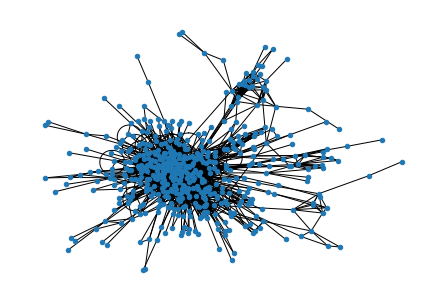

In [310]:
G=nx.from_pandas_edgelist(mmi_score, "metabolite1", "metabolite2", edge_attr=True)

# Plot it
nx.draw(G, with_labels=False, node_size = 20)
plt.show()

### Degree distribution and node centrality

,count,mean,std,min,25%,50%,75%,max
0,522.0,10.69,15.85,1.0,2.0,6.0,12.0,163.0


522
5582


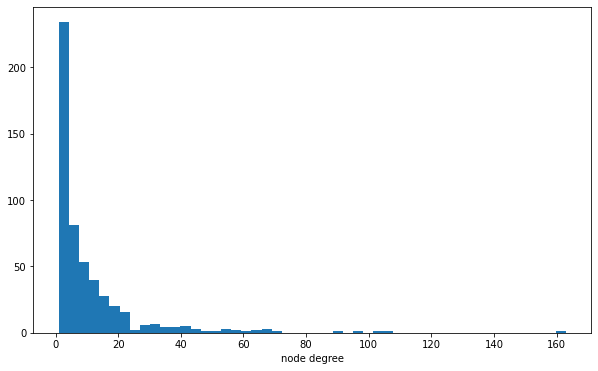

In [311]:
# degree distribution
degrees = [val for (node, val) in G.degree()]
display(pd.DataFrame(pd.Series(degrees).describe()).transpose().round(2))
print(len(degrees))
print(sum(degrees))
plt.figure(figsize=(10, 6))
plt.hist(degrees, bins=50)
plt.xlabel("node degree")
plt.show()

threshold 0.056291390728476824


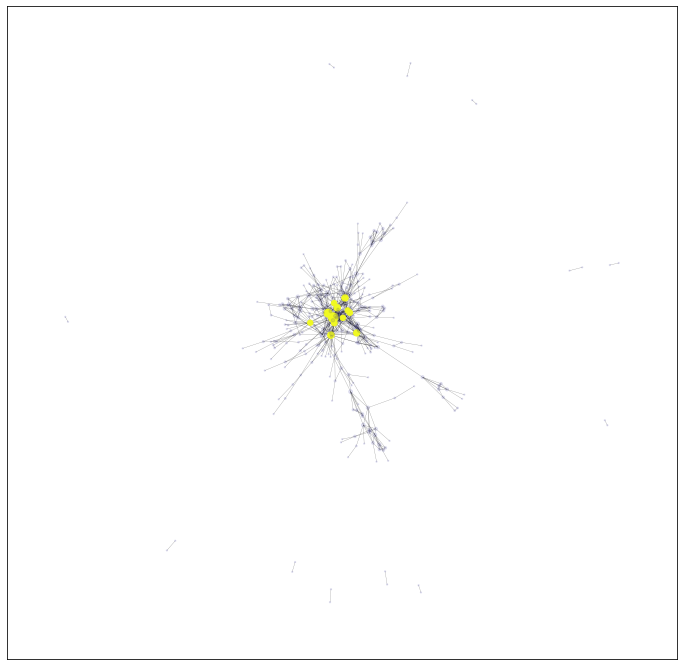

In [312]:
# node centrality
data3=mmi_score.iloc[0:1000,:] # let's pick a small subgraph for this
G3=nx.from_pandas_edgelist(data3, "metabolite1", "metabolite2", edge_attr=True)
pos = nx.spring_layout(G3, seed=42)
cent = nx.degree_centrality(G3)
node_size = list(map(lambda x: x * 500, cent.values()))
cent_array = np.array(list(cent.values()))
threshold = sorted(cent_array, reverse=True)[10]
print("threshold", threshold)
cent_bin = np.where(cent_array >= threshold, 1, 0.1)
plt.figure(figsize=(12, 12))
nodes = nx.draw_networkx_nodes(G3, pos, node_size=node_size,
                               cmap=plt.cm.plasma,
                               node_color=cent_bin,
                               nodelist=list(cent.keys()),
                               alpha=cent_bin)
edges = nx.draw_networkx_edges(G3, pos, width=0.25, alpha=0.5)
plt.show()

In [133]:
G.degree()

DegreeView({'M35': 3, 'M93': 54, 'M444': 17, 'M561': 40, 'M189': 3, 'M209': 58, 'M231': 20, 'M234': 20, 'M241': 11, 'M244': 18, 'M252': 34, 'M254': 2, 'M278': 3, 'M339': 4, 'M340': 30, 'M355': 13, 'M381': 5, 'M397': 7, 'M415': 18, 'M460': 11, 'M461': 98, 'M480': 742, 'M491': 7, 'M512': 751, 'M535': 6, 'M536': 5, 'M563': 14, 'M566': 10, 'M796': 10, 'M811': 22, 'M823': 38, 'M825': 6, 'M917': 9, 'M1001': 3, 'M1004': 11, 'M1134': 4, 'M1218': 7, 'M100000007': 4, 'M100000285': 7, 'M100000551': 3, 'M100000936': 10, 'M100001635': 2, 'M100001662': 3, 'M100001734': 3, 'M100002070': 1, 'M100002113': 4, 'M100002397': 7, 'M100002528': 18, 'M100002537': 3, 'M100004523': 7, 'M100020417': 4, 'M100000036': 5, 'M100003450': 8, 'M100004056': 5, 'M100003109': 3, 'M344': 6, 'M391': 7, 'M533': 17, 'M100000096': 3, 'M100000282': 4, 'M100000961': 2, 'M1124': 5, 'M100000784': 2, 'M100000787': 4, 'M100001612': 3, 'M100002500': 1, 'M100003271': 3, 'M376': 7, 'M393': 2, 'M50': 5, 'M212': 3, 'M136': 9, 'M197': 51,

In [140]:
G.degree('M100009271')

738

In [148]:
mmi_score[mmi_score['metabolite1']=='M100009271']

,metabolite1,metabolite2,reactions,reaction_score,Scaled_reaction_score
163368,M100009271,M1528,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163369,M100009271,M100009272,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163371,M100009271,M100009328,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163372,M100009271,M100009329,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163373,M100009271,M100009331,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
...,...,...,...,...,...
163894,M100009271,M100001466,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163895,M100009271,M100001472,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163896,M100009271,M100001501,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666
163897,M100009271,M100001502,"{'R01578', 'R04935', 'R00135', 'R01687', 'R098...",7,0.83666


In [151]:
mmi_score[mmi_score['metabolite1']=='M100009271'].iloc[0,:].reactions

"{'R01578', 'R04935', 'R00135', 'R01687', 'R09845', 'R04159', 'R04869'}"

In [152]:
mmi_score[mmi_score['metabolite1']=='M100009271'].iloc[1,:].reactions # involve reactions with 'peptide' , so all peptides participate in these reactions

"{'R01578', 'R04935', 'R00135', 'R01687', 'R09845', 'R04159', 'R04869'}"

In [153]:
# get human PPI network/graph from downloaded file

kegg_reactions_files = "../data/KEGG/kegg_reactions.csv"
kegg_reactions = pd.read_csv(kegg_reactions_files)
kegg_reactions

,ENTRY,NAME,ENZYME,RCLASS,PATHWAY
0,R00001,polyphosphate polyphosphohydrolase,3.6.1.10,NaN,NaN
1,R00002,Reduced ferredoxin:dinitrogen oxidoreductase (...,1.18.6.1,RC00002 C00002_C00008,NaN
2,R00004,diphosphate phosphohydrolase;///pyrophosphate ...,3.6.1.1,NaN,NaN
3,R00005,urea-1-carboxylate amidohydrolase,3.5.1.54,RC02756 C00011_C01010,rn00220: Arginine biosynthesis///rn00791: Atra...
4,R00006,pyruvate:pyruvate acetaldehydetransferase (dec...,2.2.1.6,RC00106 C00022_C00900,NaN
...,...,...,...,...,...
11906,R13140,NaN,1.4.3.27,NaN,NaN
11907,R13141,"homospermidine:oxygen oxidase (deaminating, cy...",1.4.3.27,NaN,NaN
11908,R13142,NaN,1.14.14.173,RC03586 C21103_C22290,NaN
11909,R13143,NaN,1.14.14.173,NaN,NaN


In [170]:
kegg_reactions[kegg_reactions['ENTRY']=='R01687']

,ENTRY,NAME,ENZYME,RCLASS,PATHWAY
1418,R01687,(5-L-glutamyl)-peptide:taurine 5-glutamyltrans...,2.3.2.2,RC00064 C00012_C03193///RC00096 C00245_C05844,rn00430: Taurine and hypotaurine metabolism


In [155]:
kegg_links

,metabolite1,metabolite2,reactions,reaction_score,Scaled_reaction_score
0,M35,M93,{'R00668'},1,0.316228
1,M35,M444,{'R00668'},1,0.316228
2,M35,M561,{'R00668'},1,0.316228
3,M93,M98,{'R12688'},1,0.316228
4,M93,M189,{'R03451'},1,0.316228
...,...,...,...,...,...
304647,M100001992,M100002028,"{'R03406', 'R02499', 'R03407'}",3,0.547723
304648,M100002067,M100002129,"{'R08978', 'R08942'}",2,0.447214
304649,M100002410,M100002968,{'R05727'},1,0.316228
304650,M100008930,M100004020,{'R08176'},1,0.316228


In [157]:
value_counts = kegg_links['reactions'].value_counts()
print(value_counts)


{'R01578', 'R04935', 'R00135', 'R01687', 'R09845', 'R04159', 'R04869'}    302253
{'R01687'}                                                                   778
{'R00135'}                                                                   778
{'R04720'}                                                                    10
{'R12501'}                                                                     8
                                                                           ...  
{'R07629'}                                                                     1
{'R03870', 'R10778'}                                                           1
{'R00913'}                                                                     1
{'R01911'}                                                                     1
{'R08176'}                                                                     1
Name: reactions, Length: 629, dtype: int64


In [166]:
import ast
df_exploded = kegg_links['reactions'].apply(ast.literal_eval)
df_exploded = df_exploded.explode()
value_counts = df_exploded.value_counts()
print(value_counts[0:20])


R00135    303031
R01687    303031
R04869    302253
R04935    302253
R04159    302253
R01578    302253
R09845    302253
R02282        10
R00578        10
R12501        10
R04720        10
R03286        10
R00986         6
R07282         6
R02283         6
R00576         6
R02817         6
R01375         6
R00692         6
R10678         6
Name: reactions, dtype: int64


In [174]:
value_counts[0]/kegg_links.shape[0] * 100

99.46791749274581

These 7 reactions account for 99% of the links in the network!

In [171]:
# Define the reaction codes you want to exclude
reactions_exclude = {'R00135', 'R01687', 'R04869', 'R04935', 'R04159', 'R01578', 'R09845'}  
# Filter the result_df to exclude the specified reaction codes
result_df_filtered = result_df[~result_df['reactions'].apply(lambda x: any(code in x for code in reaction_codes_to_exclude))]
# Display the filtered result_df
print(result_df_filtered)

0         R00668
1         R00668
2         R00668
3         R12688
4         R03451
           ...  
304651    R00135
304651    R09845
304651    R04159
304651    R01687
304651    R01578
Name: reactions, Length: 2119176, dtype: object